Transfer learning Example

Data set contains 600 training images and 150 test images of  watermelon pumpkin and tomato 

We will download VGG16 and use the convolutional layers for features.

---



The following code will  upload data from your local drive to contents folder of colab
Each time you will have to  upload the data set .You may try mapping google drive


In [1]:
from google.colab import files
uploaded = files.upload()   # uploade the dataset.zip file here

Saving dataset.zip to dataset.zip


Colab supports zip files 

In [2]:
import os
import zipfile

The following lines will unzip the dataset.zip you uploaded to a folder named data. 

In [3]:
with zipfile.ZipFile('/content/dataset.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/data')

In [4]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from tensorflow.keras.applications import vgg16

from tensorflow.keras.layers import Flatten, Dense, Dropout
from tensorflow.keras import Sequential, optimizers

from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img

import random
import os

from tensorflow.keras.applications import vgg16   # vgg 16 is here 

%matplotlib inline

/content foleder on colab is transient. You can obtain exact path by clicking on the three dots adjacent to the folder and selecting copy path.


In [5]:
# each folder contains three subfolders in accordance with the number of classes
train_dir = '/content/data/dataset/train'
validation_dir = '/content/data/dataset/validation'

image_size = 224   # our images are 224 * 224

In [6]:
# Init the VGG model Create the model 
#setting include_top parameter to False in order to exclude the fully-connected layers at the top of the network.

vgg_conv = vgg16.VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers . This will make these layers  untrainable.
for layer in vgg_conv.layers[:]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)

58900480/58889256 [==============================] - 1s 0us/step
<keras.engine.input_layer.InputLayer object at 0x7fefcd1e0850> False
<keras.layers.convolutional.Conv2D object at 0x7ff0152a1d50> False
<keras.layers.convolutional.Conv2D object at 0x7fefcc966c50> False
<keras.layers.pooling.MaxPooling2D object at 0x7fefcc8a71d0> False
<keras.layers.convolutional.Conv2D object at 0x7fefc00a09d0> False
<keras.layers.convolutional.Conv2D object at 0x7fefc00a60d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7fefc00a07d0> False
<keras.layers.convolutional.Conv2D object at 0x7fefcc90f050> False
<keras.layers.convolutional.Conv2D object at 0x7fefc00ac690> False
<keras.layers.convolutional.Conv2D object at 0x7fefc00b78d0> False
<keras.layers.pooling.MaxPooling2D object at 0x7fefc00aa310> False
<keras.layers.convolutional.Conv2D object at 0x7fefc00bb950> False
<keras.layers.convolutional.Conv2D object at 0x7fefc00c1050> False
<keras.layers.convolutional.Conv2D object at 0x7fefc00bb890> F

In [7]:
# Create the model
model = Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(Flatten())
model.add(Dense(1024, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(3, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
flatten (Flatten)            (None, 25088)             0         
_________________________________________________________________
dense (Dense)                (None, 1024)              25691136  
_________________________________________________________________
dropout (Dropout)            (None, 1024)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 3)                 3075      
Total params: 40,408,899
Trainable params: 25,694,211
Non-trainable params: 14,714,688
_________________________________________________________________


In [8]:
# Load the normalized images
# As mentioned earlier image data generator can  load data from folders


train_datagen = ImageDataGenerator(rescale=1./255)    # training data loaded and rescaled 

validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data generator for training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data generator for validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

Found 600 images belonging to 3 classes.
Found 150 images belonging to 3 classes.


In [9]:
# Utility function for quick class name access
def get_class_name(generator, image_id):
    # Get the image class and map its index with the names of the classes
    image_label_id = np.argmax(generator[image_id][1][0])
    classes_list = list(generator.class_indices.keys())
    return classes_list[image_label_id]

It is a good idea to look at Imagedatagenerator documentation in Keras


The shape of train images: (224, 224, 3)
The shape of validation images: (224, 224, 3)


Text(0.5, 1.0, 'Validation class name: tomato')

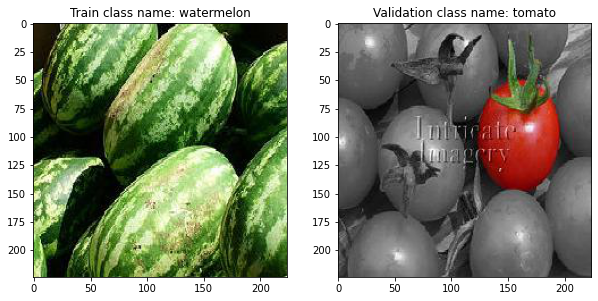

In [12]:
# Choose the image index for the visualization
image_id = 5  # try 1  to 5

# Get the train image shape 
print("The shape of train images: {}".format(train_generator[image_id][0][0].shape))

# Get the validation image shape 
print("The shape of validation images: {}".format(validation_generator[image_id][0][0].shape))

# Visualize the train image example
plt.figure(figsize=[10,5])
plt.subplot(121)
plt.imshow(train_generator[image_id][0][1])  # change 1 to 20 for other 20 the image

# Show the train image class
plt.title("Train class name: {}".format(get_class_name(train_generator, image_id)))

# Visualize the validation image example
plt.subplot(122)
plt.imshow(validation_generator[image_id][0][1])  # try changing 1

# show image class
plt.title("Validation class name: {}".format(get_class_name(validation_generator, image_id)))

In [13]:
# Utility function for plotting of the model results
def visualize_results(history):
    # Plot the accuracy and loss curves
    acc = history.history['acc']
    val_acc = history.history['val_acc']
    loss = history.history['loss']
    val_loss = history.history['val_loss']

    epochs = range(len(acc))

    plt.plot(epochs, acc, 'b', label='Training acc')
    plt.plot(epochs, val_acc, 'r', label='Validation acc')
    plt.title('Training and validation accuracy')
    plt.legend()

    plt.figure()

    plt.plot(epochs, loss, 'b', label='Training loss')
    plt.plot(epochs, val_loss, 'r', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()

    plt.show()

Epoch 1/20
6/6 [==============================] - 62s 2s/step - loss: 4.5634 - acc: 0.3717 - val_loss: 1.4617 - val_acc: 0.5800
Epoch 2/20
6/6 [==============================] - 7s 1s/step - loss: 0.8194 - acc: 0.6817 - val_loss: 0.8775 - val_acc: 0.6400
Epoch 3/20
6/6 [==============================] - 7s 1s/step - loss: 0.6139 - acc: 0.7450 - val_loss: 0.8347 - val_acc: 0.6267
Epoch 4/20
6/6 [==============================] - 7s 1s/step - loss: 0.4797 - acc: 0.7967 - val_loss: 0.5582 - val_acc: 0.7400
Epoch 5/20
6/6 [==============================] - 7s 1s/step - loss: 0.2827 - acc: 0.8950 - val_loss: 0.4118 - val_acc: 0.8400
Epoch 6/20
6/6 [==============================] - 7s 1s/step - loss: 0.2846 - acc: 0.8883 - val_loss: 0.3472 - val_acc: 0.8800
Epoch 7/20
6/6 [==============================] - 7s 1s/step - loss: 0.1219 - acc: 0.9650 - val_loss: 0.9170 - val_acc: 0.6667
Epoch 8/20
6/6 [==============================] - 7s 1s/step - loss: 0.4353 - acc: 0.8250 - val_loss: 0.7086 -

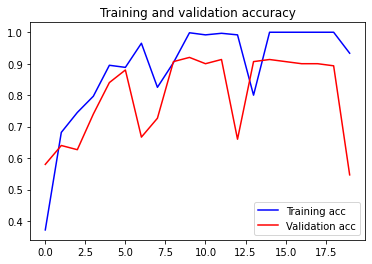

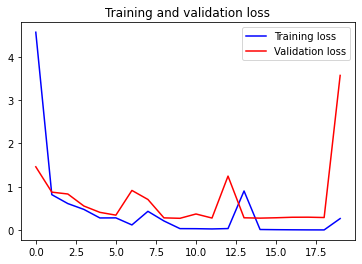

In [14]:
# Configure the model for training
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(learning_rate=1e-4),
              metrics=['acc'])

# Train the model
history = model.fit(
      train_generator,
      steps_per_epoch=train_generator.samples/train_generator.batch_size ,
      epochs=5,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the model
model.save('all_freezed.h5')

# Run the function to illustrate accuracy and loss
visualize_results(history)

In [17]:
# Utility function for obtaining of the errors 
def obtain_errors(val_generator, predictions):
    # Get the filenames from the generator
    fnames = validation_generator.filenames

    # Get the ground truth from generator
    ground_truth = validation_generator.classes

    # Get the dictionary of classes
    label2index = validation_generator.class_indices

    # Obtain the list of the classes
    idx2label = list(label2index.keys())
    print("The list of classes: ", idx2label)

    # Get the class index
    predicted_classes = np.argmax(predictions, axis=1)

    errors = np.where(predicted_classes != ground_truth)[0]
    print("Number of errors = {}/{}".format(len(errors),validation_generator.samples))
    
    return idx2label, errors, fnames

In [15]:
# Utility function for visualization of the errors
def show_errors(idx2label, errors, predictions, fnames):
    # Show the errors
    for i in range(len(errors)):
        pred_class = np.argmax(predictions[errors[i]])
        pred_label = idx2label[pred_class]

        title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
            fnames[errors[i]].split('/')[0],
            pred_label,
            predictions[errors[i]][pred_class])

        original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
        plt.figure(figsize=[7,7])
        plt.axis('off')
        plt.title(title)
        plt.imshow(original)
        plt.show()

15/15 [==============================] - 2s 121ms/step
The list of classes:  ['pumpkin', 'tomato', 'watermelon']
Number of errors = 68/150


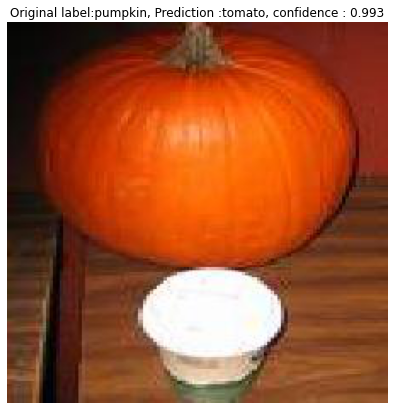

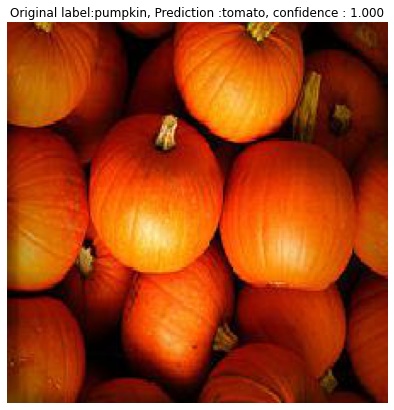

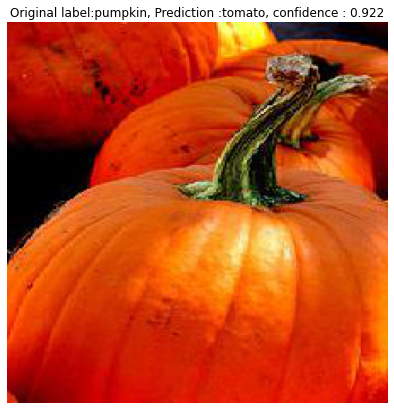

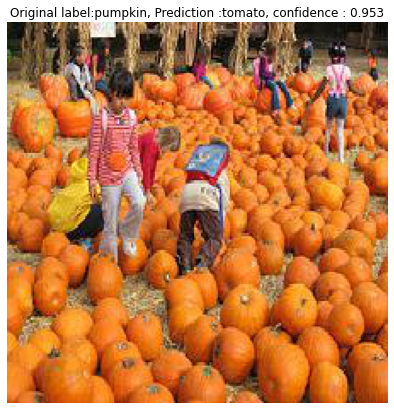

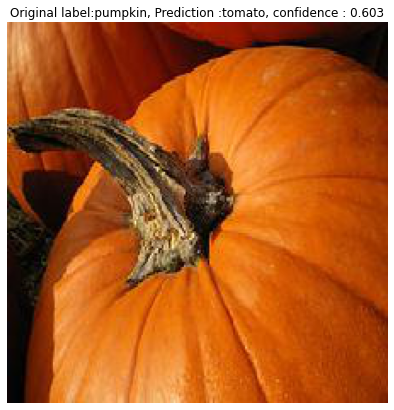

...

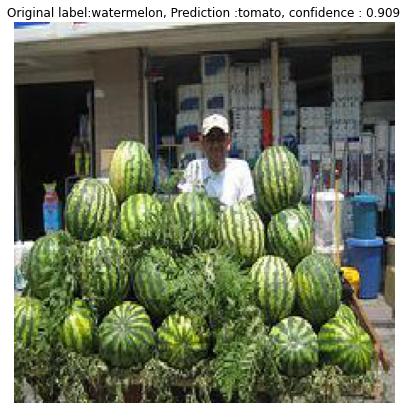

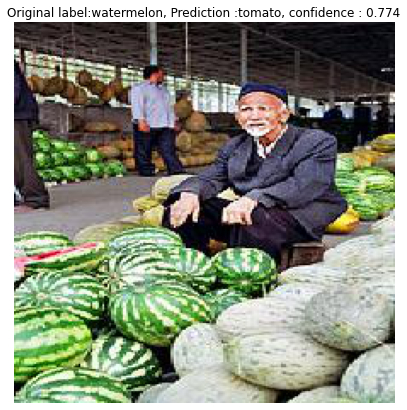

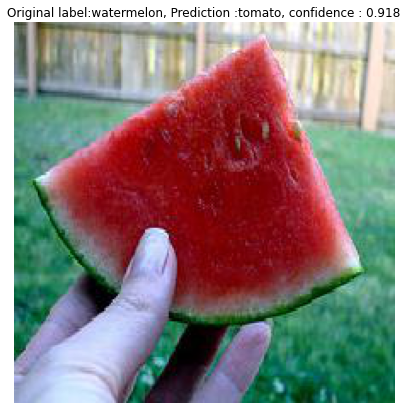

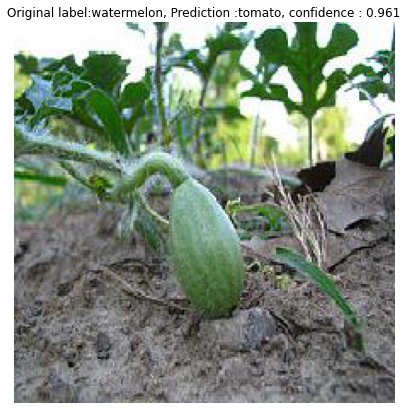

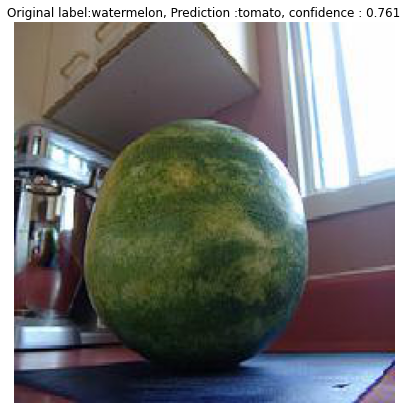

In [18]:
# Get the predictions from the model using the generator
predictions = model.predict(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)

# Run the function to get the list of classes and errors
idx2label, errors, fnames = obtain_errors(validation_generator, predictions)

# Run the function to illustrate the error cases
show_errors(idx2label, errors, predictions, fnames)